<a href="https://colab.research.google.com/github/yuntacc/AI-2021/blob/main/FaceDetection/FaceDetection202111.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# AI最火紅的技術之一: 人臉辨識

## <font color='SKYBLUE'>Key Point:</font>
### 4-1-1.人臉數據取得
### 4-1-2.OpenCV`電腦視覺`入門
### 4-1-3.`人臉辨識`實際應用

In [9]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [10]:
# Change the working directory to the material directory
%cd "//content/drive/MyDrive/Colab NB/FaceDetection" 

/content/drive/MyDrive/Colab NB/FaceDetection


In [11]:
!pwd

/content/drive/MyDrive/Colab NB/FaceDetection


## A. 人臉數據取得

### `人臉數據`採用虛擬`人臉產生器` face generator
https://thispersondoesnotexist.com/
網頁每重整一次就會顯示一張`虛擬人造臉`

### 使用`深度學習`生成`人造人臉`🧑，應用技術為深度卷積生成對抗網路（DCGAN）
### 作者是Greg gsurma，LICENSE是MIT可使用於商業用途
https://github.com/gsurma/face_generator/blob/master/LICENSE

![alt text](https://github.com/gsurma/face_generator/raw/master/assets/epochs.gif)

這都是虛擬人造人臉


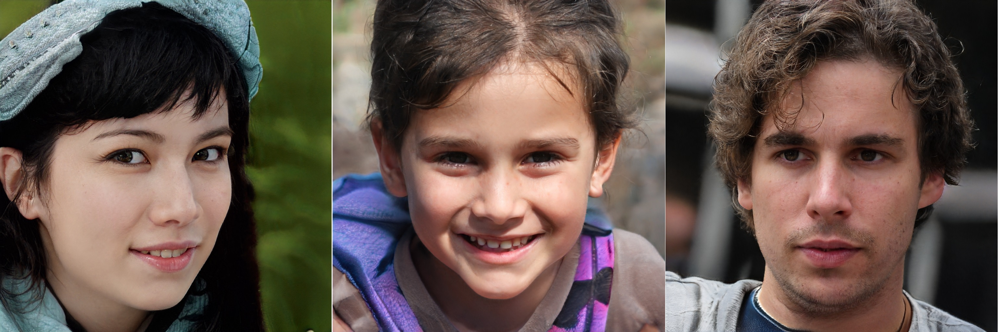

In [12]:
#虛擬人造人臉
from IPython.display import Image
print('這都是虛擬人造人臉')
Image('face31.jpg',width=600)

### 另一個數據來源是免費圖庫
https://www.pexels.com

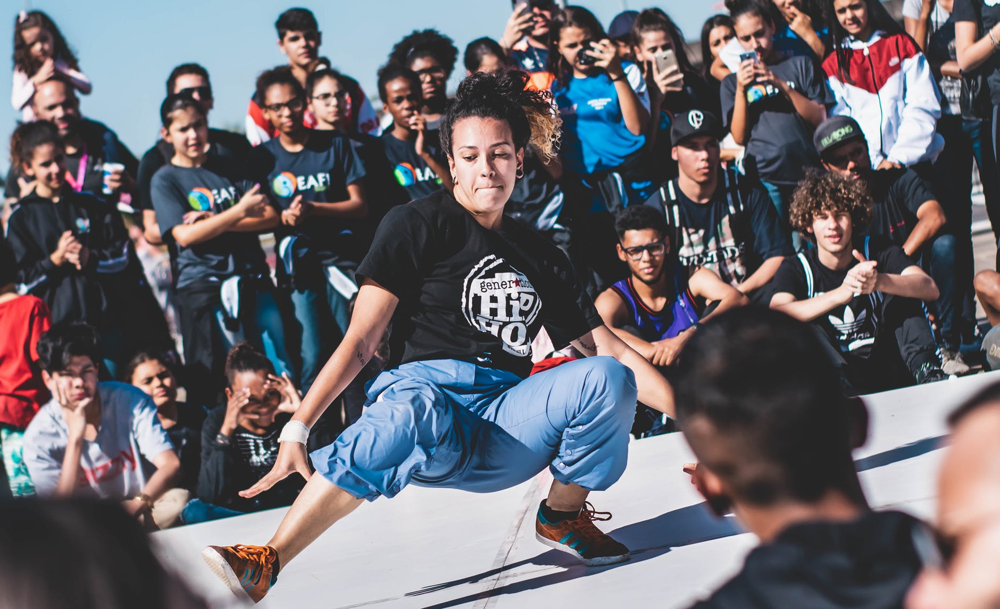

In [13]:
#4102
Image('face93.jpg',width=400)

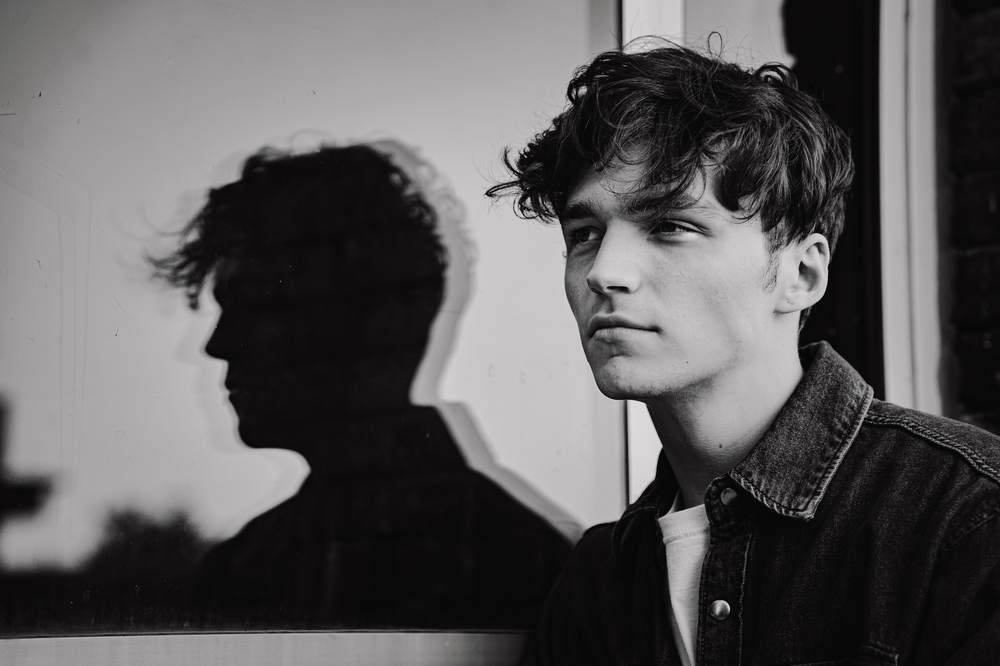

In [14]:
Image('VF01.jpg',width=400)

## 4-1-2.OpenCV`電腦視覺`入門

In [15]:
#OpenCV是電腦視覺最普及的模組，由英特爾公司發起並參與開發
#以BSD授權條款發行，可以在商業和研究領域中免費使用
%matplotlib inline
import matplotlib.pyplot as plt
import cv2
cv2.__version__ #版本不斷更新中

'4.1.2'

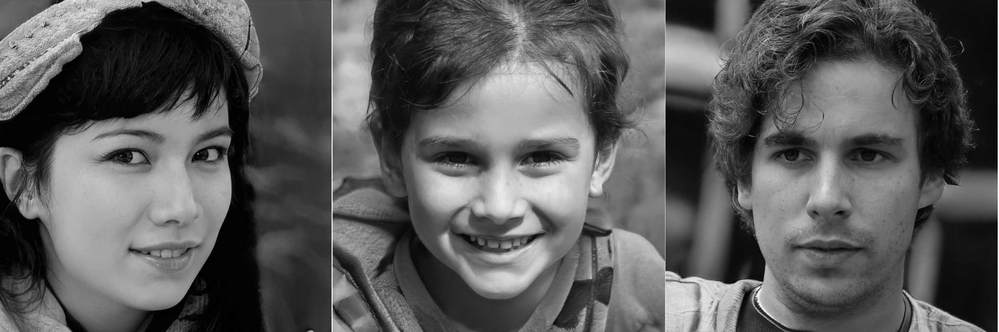

In [23]:
#4104 顯示圖片
import numpy as np
from google.colab.patches import cv2_imshow
img=cv2.imread('face31.jpg',0) #0 grayscale 1 color
#cv2.imshow('image',img)  Error? Why? cv2_imshow(img)
cv2_imshow(img)

### 🔔cv2.imshow() 在colab Jupyter 要使用 google.colab的模組

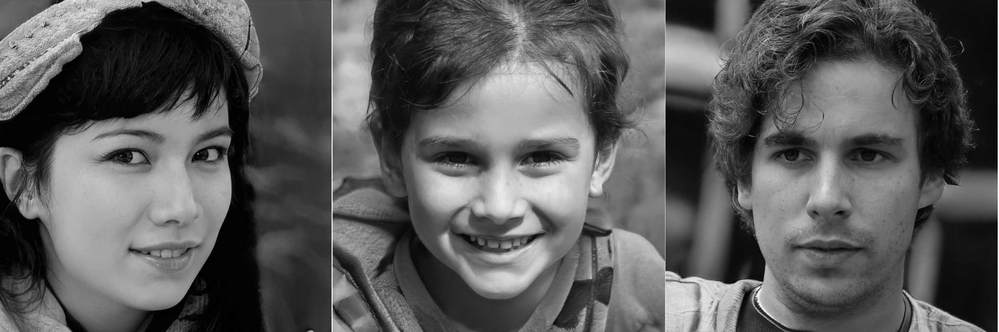

(1024, 3076)

In [24]:
#4105 在colab中改用cv2_imshow
from google.colab.patches import cv2_imshow
try:
    cv2.imshow('image',img)
except:
    cv2_imshow(img)

img.shape # 灰階或黑白圖片只有一個通道     

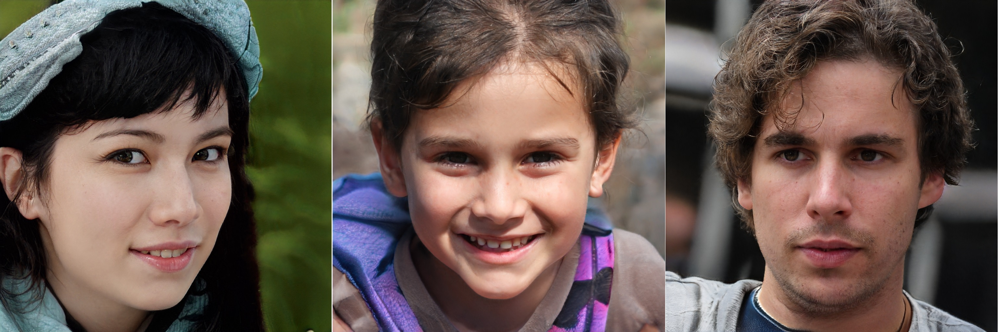

(1024, 3076, 3)

In [25]:
#4107 讀取彩色圖片
img=cv2.imread('face31.jpg',1)
cv2_imshow(img)
img.shape

### 使用matplotlib 顯示圖片

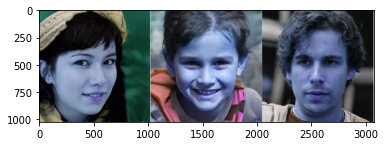

In [26]:
# 使用matplotlib 顯示圖片: openCV是 BGR
%matplotlib inline
import matplotlib.pyplot as plt
img = cv2.imread("face31.jpg") #("/content/face-filters-.jpg")
#plt.figure(figsize=(4,3))
#plt.axis("off") 
plt.imshow(img)

### 🔔openCV是 BGR，matplot是 RGB

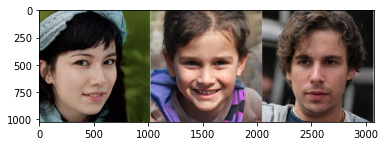

In [27]:
# 使用matplotlib: matplot是 RGB
img1=cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img1)

### RGB三通道分離

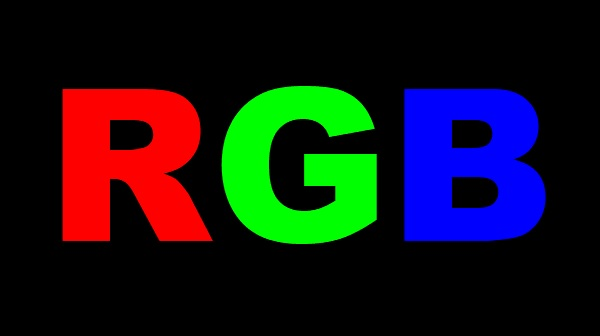

In [28]:
#RGB三通道分離
Image('RGB.jpg',width=300)

In [29]:
#RGB三通道分離
image = cv2.imread('RGB.jpg')
image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
# 通道 R:0 G:1 B:2
r = image.copy()
# : 當頭尾都省略表示全選
r[:, :, 1] = 0 # G=0(0黑色 255白)
r[:, :, 2] = 0 # B=0
 
g = image.copy()
g[:, :, 0] = 0 # R=0
g[:, :, 2] = 0 # B=0
 
b = image.copy()
b[:, :, 0] = 0
b[:, :, 1] = 0

image.shape

(336, 600, 3)

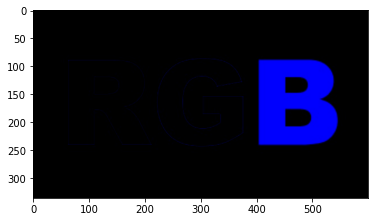

In [30]:
#RGB三通道分離
plt.imshow(b)

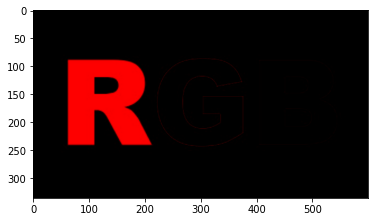

In [31]:
#RGB三通道分離
plt.imshow(r)

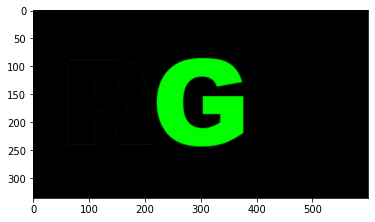

In [32]:
#RGB三通道分離
plt.imshow(g)

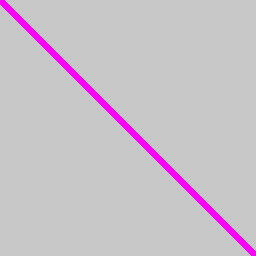

In [33]:
# openCV簡易繪圖範例
import numpy as np
# 建立一張 256x256 的 RGB 圖片（0黑色）
img = np.zeros((256, 256, 3), np.uint8) #np.zeros建立0矩陣
# 將圖片用淺灰色 (200, 200, 200) 填滿
img.fill(200)
# 在圖片上畫一條紫紅色的對角線，寬度為 5 px (0,0在最左上角)
# cv2.line(影像, 開始座標, 結束座標, 顏色, 線條寬度)
cv2.line(img, (0, 0), (255, 255), (255, 0, 255), 5)
# 顯示圖片
cv2_imshow(img)

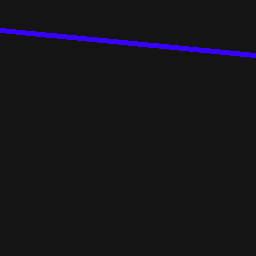

In [34]:
img = np.zeros((256, 256, 3), np.uint8) #np.zeros建立0矩陣
# 將圖片用淺灰色 (200, 200, 200) 填滿
img.fill(20)
# 在圖片上畫一條紫紅色的對角線，寬度為 5 px (0,0在最左上角)
# cv2.line(影像, 開始座標, 結束座標, 顏色, 線條寬度)
cv2.line(img, (0, 30), (255, 55), (255, 0, 55), 3)
# 顯示圖片
cv2_imshow(img)

### 下載open CV 人臉分類器 

In [35]:
# 下載open CV 人臉分類器!!
# 使用特徵檢測+機器學習演算法，從影像中找到人臉
!wget https://raw.githubusercontent.com/opencv/opencv/master/data/haarcascades/haarcascade_frontalface_default.xml

--2021-11-01 13:03:51--  https://raw.githubusercontent.com/opencv/opencv/master/data/haarcascades/haarcascade_frontalface_default.xml
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 930127 (908K) [text/plain]
Saving to: ‘haarcascade_frontalface_default.xml.2’

haarcascade_frontal 100%[===================>] 908.33K  --.-KB/s    in 0.06s   

2021-11-01 13:03:52 (15.0 MB/s) - ‘haarcascade_frontalface_default.xml.2’ saved [930127/930127]



## openCV辨識人臉4步驟

In [36]:
# ****** openCV辨識人臉4步驟 ******
# 1.載入圖片
image = cv2.imread('face31.jpg')
# 2.載入分類器
haar = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')
# 3.圖片轉灰階
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
# 4.使用分類器從圖片找到人臉
faces = haar.detectMultiScale(gray) #偵測人臉
# 得到的結果是 臉的左上角座標與寬、高的像素座標(0,0在最左上角)
print("找到臉的數量=",len(faces))
print(faces)

找到臉的數量= 3
[[2208  213  685  685]
 [ 118  198  732  732]
 [1174  211  715  715]]


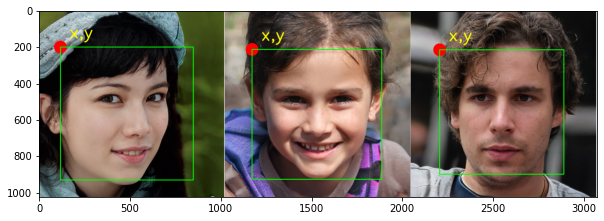

In [37]:
#找到臉的數量= 3
for (x,y,w,h) in faces: #左上角座標x,y與寬w、高h
    #圓形 cv2.circle(影像, 圓心座標, 半徑, 顏色, 線條寬度) 負數代表實心
    cv2.circle(image,(x, y), 35, (0, 0, 255), -1) #紅點標示x,y
    #矩形 cv2.rectangle(影像, 頂點座標, 對向頂點座標, 顏色, 線條寬度)
    cv2.rectangle(image,(x,y),(x+w,y+h),(0,255,0),3) #畫矩形框 可改框的顏色/線條粗細
    #文字 cv2.putText(影像, 文字, 座標, 字型, 大小, 顏色, 線條寬度, 線條種類)
    cv2.putText(image, ('x,y'), (x+50, y-50), cv2.FONT_HERSHEY_SIMPLEX,
    3, (0, 255, 255), 5, cv2.LINE_AA)
plt.figure(figsize=(10,4)) #設定顯示尺寸
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)) #BGR to RGB

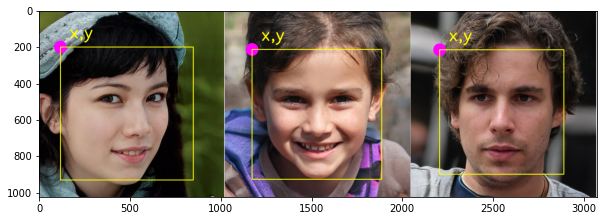

In [38]:
#找到臉的數量= 3
for (x,y,w,h) in faces: #左上角座標x,y與寬w、高h
    #圓形 cv2.circle(影像, 圓心座標, 半徑, 顏色, 線條寬度) 負數代表實心
    cv2.circle(image,(x, y), 35, (255, 0, 255), -1) #紅點標示x,y
    #矩形 cv2.rectangle(影像, 頂點座標, 對向頂點座標, 顏色, 線條寬度)
    cv2.rectangle(image,(x,y),(x+w,y+h),(0,255,255),3) #畫矩形框 可改框的顏色/線條粗細
    #文字 cv2.putText(影像, 文字, 座標, 字型, 大小, 顏色, 線條寬度, 線條種類)
    cv2.putText(image, ('x,y'), (x+50, y-50), cv2.FONT_HERSHEY_SIMPLEX,
    3, (0, 255, 255), 5, cv2.LINE_AA)
plt.figure(figsize=(10,4)) #設定顯示尺寸
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)) #BGR to RGB

### 實作練習1.找一張圖片有10個以上人臉,並偵測人臉數量


17


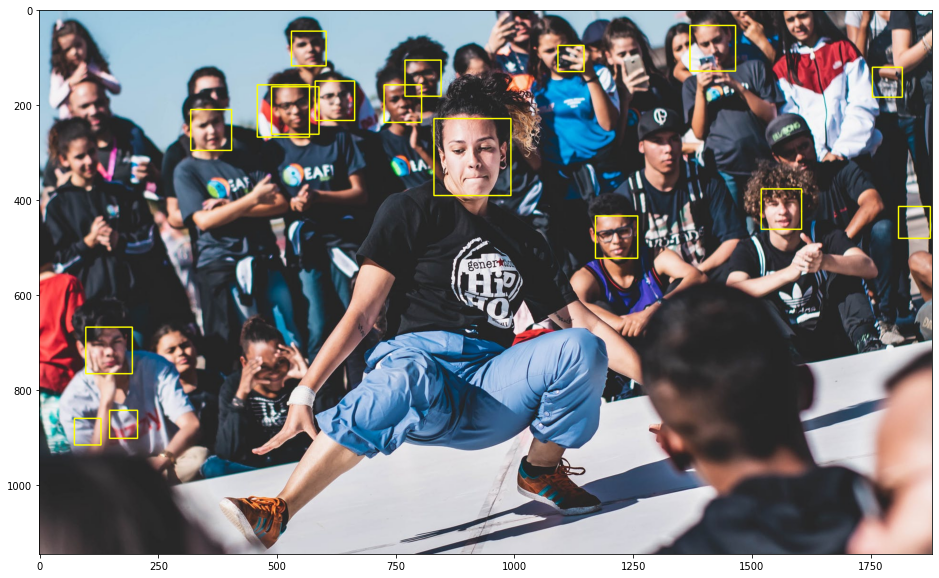

In [39]:
#找一張圖片有10個以上人臉,並偵測人臉數量
image = cv2.imread('face93.jpg')
haar = cv2.CascadeClassifier('haarcascade_frontalface_default.xml') #載入分類器
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)#圖片轉灰階
faces = haar.detectMultiScale(gray) #偵測人臉
for (x,y,w,h) in faces:
    cv2.rectangle(image,(x,y),(x+w,y+h),(0,255,255),2) #畫矩形框 可改框的顏色/線條粗細
plt.figure(figsize=(16,12)) #設定顯示尺寸
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)) #BGR to RGB
print(len(faces))

## `人臉辨識`實際應用

### face_recognition 是python第三方模組，基於深度學習的人臉辨識功能

In [43]:
# face_recognition 是python第三方模組，基於深度學習的人臉辨識功能
!pip install face_recognition #安裝模組

In [44]:
#4118 face_recognition 是python第三方模組，基於深度學習的人臉辨識功能
import face_recognition #人臉辨識模組

找到臉的數量= 19


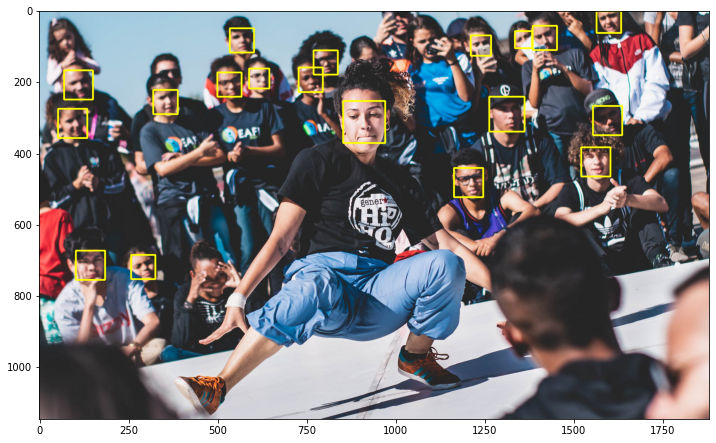

In [45]:
#face_recognition 是python第三方模組，基於深度學習的人臉辨識功能
image = face_recognition.load_image_file("face93.jpg")
faces = face_recognition.face_locations(image,model='cnn')
print("找到臉的數量=",len(faces))
for (top, right, bottom, left) in faces: #畫矩形框 可改框的顏色/線條粗細
    cv2.rectangle(image, (left, top), (right, bottom), (255, 255, 0), 3)
plt.figure(figsize=(12,10))
#plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.imshow(image)

### 實作練習2.找一張圖片有10~20個人臉,並偵測人臉數量

找到臉的數量= 35


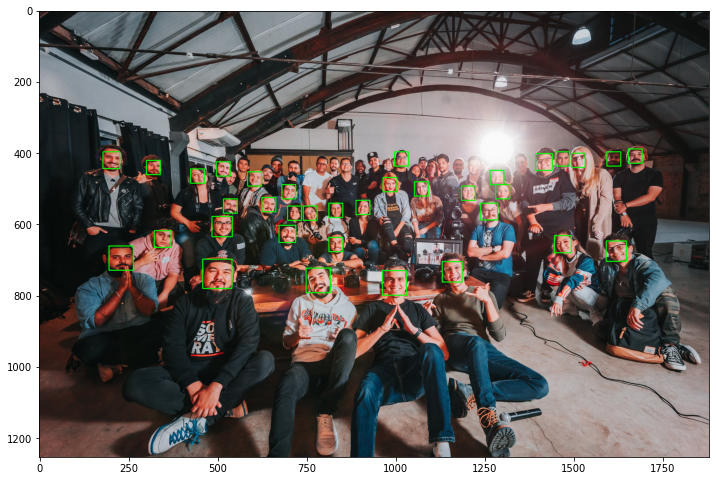

In [46]:
#4120
import cv2
import face_recognition
%matplotlib inline
import matplotlib.pyplot as plt
image = face_recognition.load_image_file("face92.jpg") #92
faces = face_recognition.face_locations(image,model='cnn')
print("找到臉的數量=",len(faces))
for (top, right, bottom, left) in faces: #畫矩形框 可改框的顏色/線條粗細
    cv2.rectangle(image, (left, top), (right, bottom), (0, 255, 0), 2)
plt.figure(figsize=(12,10))
#plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.imshow(image)

### 🔔如果發生記憶體不足 RuntimeError: Error while calling cudaGetLastError() in file /tmp/pip-wheel-b9ck8go0/dlib/dlib/cuda/gpu_data.cpp:114. code: 2, reason: out of memory

### `Runtime > Restart runtime`

In [ ]:
# 1. Restart runtime; 2. Change directory again
%cd "/content/drive/MyDrive/Colab NB"

## Homework: 

In [ ]:
#Homework
# H1.找一些很多人臉的照片，測試兩種人臉辨識方法
#    哪一種好用? 你最多可以找到幾張臉?

# H2.你會在照片上使用openCV繪圖或是寫文字嗎?


找到臉的數量= 26


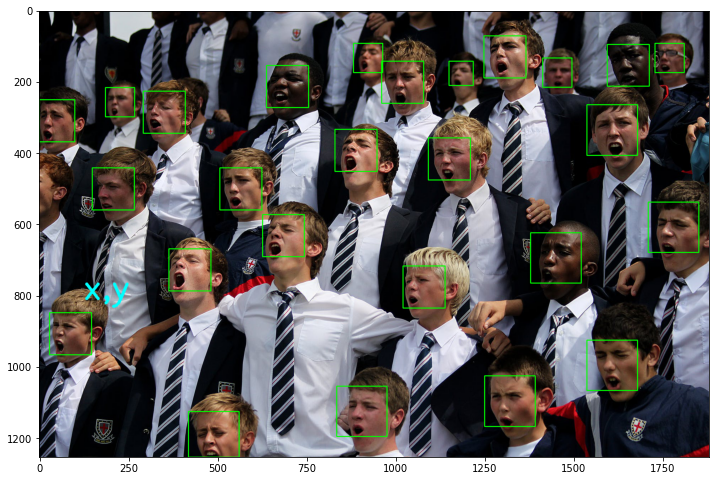

In [51]:
import cv2
import face_recognition
%matplotlib inline
import matplotlib.pyplot as plt
image = face_recognition.load_image_file("face94.jpg") #92
faces = face_recognition.face_locations(image,model='cnn')
print("找到臉的數量=",len(faces))
for (top, right, bottom, left) in faces: #畫矩形框 可改框的顏色/線條粗細
    cv2.rectangle(image, (left, top), (right, bottom), (0, 255, 0), 2)
    cv2.putText(image, ('x,y'), (x+50, y-50), cv2.FONT_HERSHEY_SIMPLEX,
    3, (0, 255, 255), 5, cv2.LINE_AA)
plt.figure(figsize=(12,10))
#plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.imshow(image)

### 實用`人臉馬賽克`

找到臉的數量= 3


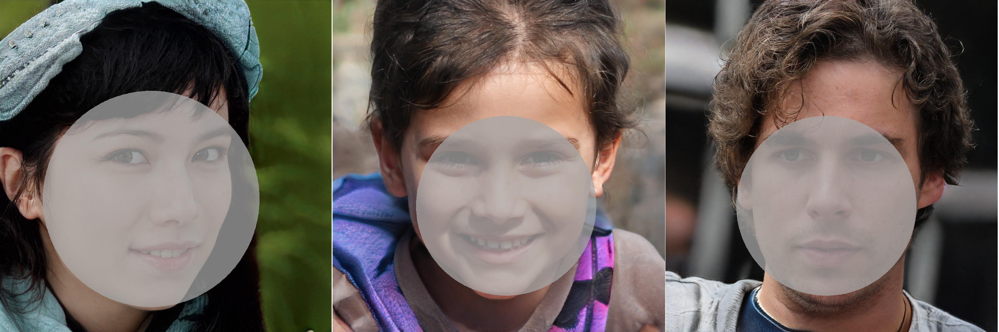

In [52]:
#實用人臉馬賽克
from PIL import Image, ImageDraw #顯示圖片
image = face_recognition.load_image_file("face31.jpg")
faces = face_recognition.face_locations(image) # ,model='cnn')
print("找到臉的數量=",len(faces))
pil_image = Image.fromarray(image)
for (top, right, bottom, left) in faces: #取出座標
    draw = ImageDraw.Draw(pil_image, 'RGBA') #RGB A:透明度
    leftUpPoint = (left, top) #左上角
    rightDownPoint = (right, bottom) #右下角
    twoPointList = [leftUpPoint, rightDownPoint] #兩點畫圓
    draw.ellipse(twoPointList, fill=(166,166,166,190))
    pil_image.show()
display(pil_image)

### 快速人臉馬賽克

找到臉的數量= 19


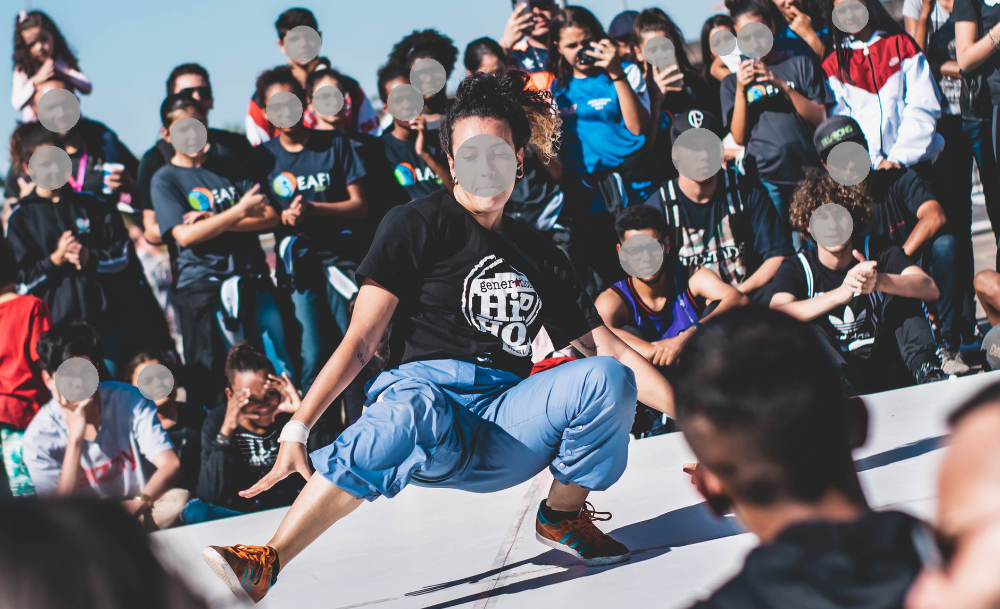

In [53]:
# 快速人臉馬賽克
image = face_recognition.load_image_file("face93.jpg")
faces = face_recognition.face_locations(image ,model='cnn')
print("找到臉的數量=",len(faces))
pil_image = Image.fromarray(image)
for (top, right, bottom, left) in faces: #取出座標
    draw = ImageDraw.Draw(pil_image, 'RGBA') #RGB A:透明度
    leftUpPoint = (left, top) #左上角
    rightDownPoint = (right, bottom) #右下角
    twoPointList = [leftUpPoint, rightDownPoint] #兩點畫圓
    draw.ellipse(twoPointList, fill=(166,166,166,205))
    pil_image.show()
pil_image.save("output.jpg")
display(pil_image)